# Assignment 3 - Text Analysis
An explanation this assignment could be found in the .pdf explanation document


## Materials to review for this assignment
<h4>From Moodle:</h4> 
<h5><u>Review the notebooks regarding the following python topics</u>:</h5>
<div class="alert alert-info">
&#x2714; <b>Working with strings</b> (tutorial notebook)<br/>
&#x2714; <b>Text Analysis</b> (tutorial notebook)<br/>
&#x2714; <b>Hebrew text analysis tools (tokenizer, wordnet)</b> (moodle example)<br/>
&#x2714; <b>(brief review) All previous notebooks</b><br/>
</div> 
<h5><u>Review the presentations regarding the following topics</u>:</h5>
<div class="alert alert-info">
&#x2714; <b>Text Analysis</b> (lecture presentation)<br/>
&#x2714; <b>(brief review) All other presentations</b><br/>
</div>

## Personal Details:

In [1]:
# Details Student 1:
'Yair Yatzkan'
# Details Student 2:
'Arad David'

'Arad David'

## Preceding Step - import modules (packages)
This step is necessary in order to use external modules (packages). <br/>

In [2]:
# --------------------------------------
import pandas as pd
import numpy as np
# --------------------------------------


# --------------------------------------
# ------------- visualizations:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
# --------------------------------------


# ---------------------------------------
import sklearn
from sklearn import preprocessing, metrics, pipeline, model_selection, feature_extraction 
from sklearn import naive_bayes, linear_model, svm, neural_network, neighbors, tree
from sklearn import decomposition, cluster

from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV 
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import mean_squared_error, r2_score, silhouette_score
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder

from sklearn.svm import LinearSVC
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import Perceptron, SGDClassifier
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
# ---------------------------------------


# ----------------- output and visualizations: 
import warnings
from sklearn.exceptions import ConvergenceWarning
warnings.simplefilter("ignore")
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter("ignore", category=ConvergenceWarning)
# show several prints in one cell. This will allow us to condence every trick in one cell.
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
%matplotlib inline
pd.pandas.set_option('display.max_columns', None)
pd.set_option('display.float_format', lambda x: '%.3f' % x)
# ---------------------------------------

### Text analysis and String manipulation imports:

In [3]:
# --------------------------------------
# --------- Text analysis and Hebrew text analysis imports:
# vectorizers:
from sklearn.feature_extraction import text
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

# regular expressions:
import re
# --------------------------------------

### (optional) Hebrew text analysis - WordNet (for Hebrew)
Note: the WordNet is not a must

#### (optional) Only if you didn't install Wordnet (for Hebrew) use:

In [4]:
# word net installation:

# unmark if you want to use and need to install
#!pip install wn
#!python -m wn download omw-he:1.4

In [5]:
# word net import:

# unmark if you want to use:
#import wn

### (optional) Hebrew text analysis - hebrew_tokenizer (Tokenizer for Hebrew)
Note: the hebrew_tokenizer is not a must

#### (optional) Only if you didn't install hebrew_tokenizer use:

In [6]:
# Hebrew tokenizer installation:

# unmark if you want to use and need to install:
#!pip install hebrew_tokenizer

In [7]:
# Hebrew tokenizer import:

# unmark if you want to use:
import hebrew_tokenizer as ht

/Users/araddavid/Desktop/ML-Task3/Hebrew-Text-Analyze


### Reading input files
Reading input files for train annotated corpus (raw text data) corpus and for the test corpus

In [8]:
train_filename = 'annotated_corpus_for_train.csv'
test_filename  = 'corpus_for_test.csv'
df_train = pd.read_csv(train_filename, index_col=None, encoding='utf-8')
df_test  = pd.read_csv(test_filename, index_col=None, encoding='utf-8')

In [9]:
df_train.head(8)
df_train.shape

,story,gender
0,"כשחבר הזמין אותי לחול, לא באמת חשבתי שזה יקרה,...",m
1,לפני שהתגייסתי לצבא עשיתי כל מני מיונים ליחידו...,m
2,מאז שהתחילו הלימודים חלומו של כל סטודנט זה הפנ...,f
3,"כשהייתי ילד, מטוסים היה הדבר שהכי ריתק אותי. ב...",m
4,‏הייתי מדריכה בכפר נוער ומתאם הכפר היינו צריכי...,f
5,לפני כ3 חודשים טסתי לרומא למשך שבוע. טסתי במטו...,f
6,אני כבר שנתיים נשוי והשנה אני ואישתי סוף סוף י...,m
7,השנה התחלנו שיפוץ בדירה שלנו בתל אביב. הדירה ה...,f


(753, 2)

In [10]:
df_test.head(3)
df_test.shape

,test_example_id,story
0,0,כל קיץ אני והמשפחה נוסעים לארצות הברית לוס אנג...
1,1,"הגעתי לשירות המדינה אחרי שנתיים כפעיל בתנועת ""..."
2,2,אחת האהבות הגדולות שלי אלו הכלבים שלי ושל אישת...


(323, 2)

### Your implementation:
Write your code solution in the following code-cells

### Cleaning Unnecerry Words
----------------------------------------
First the Function gets List of tokens Per Story.
Before We are pushing the Tokens per story to the whole DataFrame ,
We are cleaning some unnecary word like :
 - 1 letter words , there is no 1 letter words in hebrew
 - Numbers, numbers is not something that can help to predict the gender
 - Words that are not in hebrew
-----------------------------------------
The function filters all mentiond above , and then returns a list of the tokens Per story.

In [11]:
# YOUR CODE HERE
def cleanUnNecWords(tokenListPerStory):
    
    cleanTokenPerStory = []
    for tok in tokenListPerStory:
        validToken = True 
        if(len(tok) > 1): ## Contiue the Valdiation only if the word is bigger than one, there is not hebrew word with len 1
            for letter in tok: 
                if (ord(letter) < ord("א") or ord(letter) > ord("ת")):##If the word is not in hebrew its not neccesrety for the dataframe
                    validToken = False
                    break

            if(validToken): ## Only if the word is in Hebrew and also bigger than 1 letter its valid
                cleanTokenPerStory.append(tok)
                    
    return cleanTokenPerStory

### Pre Process Function
---------------------------------
The pre process function , is using the Hebrew_Toknizer.
This function gets DataFrame as input(by refernce)
first of all it takes the story, than using the toknizer and after that call to the cleanUnNecWords function.
after the tokens list is clean , we are pushing it into big list , who holds the all stories tokens.
and than when the list has all the stories tokens we are addding into the dataframe.

In [12]:
def preProcess(dataFrame):
    tokens_list=[]
    #tokenizing
    for story in dataFrame['story']: 
        tokens=ht.tokenize(story)
        tok_lst_per_story=[]
        for tok in tokens: #creating token list per story
            tok_lst_per_story.append(tok[1])
            
        cleanToksPerStory = cleanUnNecWords(tok_lst_per_story)
        tokens_list.append(cleanToksPerStory) ## List of token after cleaning unneccsry words
    dataFrame['tokens']=tokens_list

In [13]:
df_train_copy=df_train.copy()
df_train_copy['gender_label']=df_train_copy['gender'].apply(lambda gen: 1 if gen=='m' else 0)#convert gender to numeric

preProcess(df_train_copy)      
df_train_copy.head(10)

,story,gender,gender_label,tokens
0,"כשחבר הזמין אותי לחול, לא באמת חשבתי שזה יקרה,...",m,1,"[כשחבר, הזמין, אותי, לחול, לא, באמת, חשבתי, שז..."
1,לפני שהתגייסתי לצבא עשיתי כל מני מיונים ליחידו...,m,1,"[לפני, שהתגייסתי, לצבא, עשיתי, כל, מני, מיונים..."
2,מאז שהתחילו הלימודים חלומו של כל סטודנט זה הפנ...,f,0,"[מאז, שהתחילו, הלימודים, חלומו, של, כל, סטודנט..."
3,"כשהייתי ילד, מטוסים היה הדבר שהכי ריתק אותי. ב...",m,1,"[כשהייתי, ילד, מטוסים, היה, הדבר, שהכי, ריתק, ..."
4,‏הייתי מדריכה בכפר נוער ומתאם הכפר היינו צריכי...,f,0,"[הייתי, מדריכה, בכפר, נוער, ומתאם, הכפר, היינו..."
5,לפני כ3 חודשים טסתי לרומא למשך שבוע. טסתי במטו...,f,0,"[לפני, חודשים, טסתי, לרומא, למשך, שבוע, טסתי, ..."
6,אני כבר שנתיים נשוי והשנה אני ואישתי סוף סוף י...,m,1,"[אני, כבר, שנתיים, נשוי, והשנה, אני, ואישתי, ס..."
7,השנה התחלנו שיפוץ בדירה שלנו בתל אביב. הדירה ה...,f,0,"[השנה, התחלנו, שיפוץ, בדירה, שלנו, בתל, אביב, ..."
8,עד לפני כמה חודשים אני הייתי בטוח שכל חיי אהיה...,m,1,"[עד, לפני, כמה, חודשים, אני, הייתי, בטוח, שכל,..."
9,"בן זוגי חגג יום הולדת, ורציתי להפתיע אותו ולסג...",f,0,"[בן, זוגי, חגג, יום, הולדת, ורציתי, להפתיע, או..."


### CreateVectorizer Function
-----------------------------------
This function is getting as input a DataFrame , Vectorizer Type(Count,idf...) and bool that indicats if we need to use this function as train or for the prediction.
the Vectorizer function gets a list of strings as input , so we are converting the Clean tokens to strings and pushing into a list , every cell in this list holds one story from the stories DataFrame.

The fucntion returns the Vectorizer as DataFrame , all the tokens are Features and every story is a row.

In [14]:
# Add as many code cells as you need
# YOUR CODE HERE
def createVectorizer(dataFrame,vectoType,isTrain):
    allStoriesClean = []
    for tk in dataFrame["tokens"]:### Creating From The clean tokens string so we create CountVectorizer
        allStoriesClean.append(' '.join(tk)) 
    
    if(isTrain):
        beforeArr = vectoType.fit_transform(allStoriesClean)
    else:
        beforeArr = vectoType.transform(allStoriesClean)

    arr = beforeArr.toarray()
    xFinal = pd.DataFrame(arr, columns=vectoType.get_feature_names_out())

    return xFinal
  
    
    


In [15]:
#first and simple vectorization process to get the training data
countVec = CountVectorizer()
xTrainC = createVectorizer(df_train_copy,countVec,True)
xTrainC.head(5)

,אאוט,אאוטפיטים,אב,אבא,אבבה,אבד,אבדה,אבדוק,אבדנו,אבהות,אבו,אבוא,אבוב,אבוד,אבודה,אבודי,אבודים,אבוי,אבוני,אבוקות,אבות,אבותינו,אבזרנו,אבחון,אבחר,אבטחה,אבטחת,אבטיח,אבטלה,אבי,אביא,אביב,אביבי,אביביים,אביבית,אבידת,אביה,אביהן,אביו,אביזרים,אבים,אבין,אבל,אבן,אבנה,אבנים,אבק,אבקר,אבקש,אברהם,אברח,אבריא,אבשלום,אג,אגב,אגדה,אגדיל,אגודת,אגוון,אגיב,אגיד,אגיע,אגם,אגמים,אגן,אגרום,אגרסיבי,אגרסיבית,אגרסיות,אגשים,אדאג,אדביק,אדבק,אדווייזור,אדווין,אדום,אדומה,אדומות,אדון,אדוני,אדי,אדיב,אדיבות,אדיבים,אדידס,אדים,אדיס,אדיר,אדירה,אדירות,אדירים,אדירכלית,אדיש,אדם,אדמדמים,אדמה,אדממה,אדני,אדע,אדריכלות,אדריכלים,אדרנלין,אה,אהב,אהבה,אהבו,אהבנו,אהבת,אהבתי,אהדה,אהוב,אהובה,אהובים,אהובתי,אהיה,אהנה,או,אוב,אובד,אובדן,אובחנתי,אובט,אובי,אובייקט,אובייקטים,אובר,אוגוסט,אוגנדה,אודות,אודי,אודיע,אודישן,אודישנים,אודם,אוהב,אוהבות,אוהבים,אוהבת,אוהג,אוהד,אוהדי,אוהדים,אוהל,אוהלים,אוואי,אוודא,אווי,אוויס,אוויר,אווירה,אווירי,אווירית,אווירת,אוורירי,אוותר,אוזן,אוזניות,אוזניי,אוזניים,אוחזת,אוט,אוטו,אוטובוס,אוטובוסים,אוטובסים,אוטוטו,אוטומט,אוטומטי,אוטומטיות,אוטומטים,אוטומטית,אוטומציה,אוטנטית,אוי,אויב,אויירת,אויר,אוירה,אוכל,אוכלוסיות,אוכלוסייה,אוכלוסית,אוכלות,אוכלים,אוכלסיות,אוכלת,אולד,אולטרא,אולטרה,אולטרסאונד,אולי,אוליי,אולימפיקו,אולם,אולמות,אולפן,אולפני,אולר,אומגה,אומגות,אומטפה,אומלל,אומנה,אומנות,אומנים,אומנם,אומץ,אומר,אומרות,אומרים,אומרת,אונו,אוניברסיטאי,אוניברסיטה,אוניברסיטת,אוניברסלי,אוניה,אונייה,אונים,אוניסריטה,אונליין,אוסבורן,אוסטריה,אוסטרליה,אוסיף,אוסישקין,אוסף,אוספים,אוסקורפ,אוסר,אוף,אופטיות,אופטימי,אופטימיות,אופטימיים,אופטימים,אופטימית,אופטלגין,אופי,אופיה,אופיים,אופייני,אופיס,אופיר,אופן,אופנה,אופנוע,אופנועי,אופנועים,אופני,אופניים,אופנים,אופנעי,אופנתיים,אופציה,אופציות,אופציית,אופק,אופקים,אופתע,אוצה,אוציא,אוקטובר,אוקטופוס,אוקטן,אוקי,אוקיי,אוקראיני,אור,אורגניי,אורו,אורוכות,אורות,אורז,אורח,אורחי,אורחים,אורחת,אורט,אורטופד,אורי,אוריד,אורך,אורכה,אורכו,אורשה,אורתופדי,אושוויה,אושפז,אושפזתי,אושר,אושרה,אות,אותה,אותו,אותוו,אותות,אותותיה,אותי,אותיות,אותך,אותכם,אותם,אותן,אותנו,אותנטי,אותנטיות,אותנטיים,אותנטים,אותנטית,אותתי,אז,אזהרה,אזהרות,אזובים,אזור,אזורי,אזורים,אזי,אזיז,אזכה,אזכור,אזעקה,אזעקת,אזק,אזקו,אזרוק,אזרח,אזרחות,אזרחי,אזרחיות,אזרחים,אזרחית,אזרתי,אח,אחאי,אחאנו,אחגוג,אחד,אחדות,אחה,אחווה,אחוז,אחוזי,אחוזים,אחורה,אחורי,אחורנה,אחורנית,אחוש,אחות,אחותה,אחותו,אחותי,אחזור,אחזקה,אחזתי,אחי,אחיה,אחיו,אחיותי,אחיזה,אחיי,אחייג,אחיין,אחיינים,אחים,אחיניותיי,אחכ,אחכה,אחלה,אחמד,אחסון,אחפור,אחפש,אחר,אחראי,אחראיות,אחראים,אחראית,אחרון,אחרונה,אחרונות,אחרונים,אחרות,אחרי,אחריה,אחריהם,אחריהן,אחריו,אחריות,אחריותה,אחריי,אחרים,אחרינו,אחריץ,אחרכך,אחרת,אחשוש,אחת,אחתום,אט,אטומה,אטוס,אטיב,אטייל,אטלנטה,אטלנטיס,אטפל,אטרף,אטרקטיבית,אטרקיצה,אטרקציה,אטרקציות,אי,איאוו,איבד,איבדה,איבדו,איבדנו,איבדתי,איבוד,איבר,איברהיים,איגדנו,איגוד,איגוסטרס,אידיאולוגיות,אידיאלי,איה,איו,איוורור,איולי,איום,איומה,איומי,איומים,איז,איזה,איזו,איזון,איזור,איזושהי,איזנקוט,איזשהו,איזשהי,איזשהיא,איחדה,איחוד,איחור,איחל,איחלנו,איחלתי,איחר,איחרה,איחרנו,איחרתי,איטי,איטיים,איטית,איטליה,איטלקי,איטלקים,איטלקית,איי,אייל,איילון,איילים,איים,איימה,איימים,איימל,איימתי,איינהירנינגור,איינטנסיבים,איינשטיין,אייפד,אייפון,אייפל,איירביאנדבי,אייריס,איישתי,איך,איכון,איכות,איכותי,איכותיים,איכותית,איכזב,איכלס,איכן,איכפת,איכרים,איכשהו,איל,אילו,אילון,אילוף,אילוצי,אילצה,אילת,אילתים,אילתרתי,אימא,אימה,אימו,אימון,אימוני,אימונים,אימוץ,אימי,אימייל,אימיילים,אימים,אימצנו,אימצתי,אימתה,אין,אינדיבידואלי,אינדקציה,אינה,אינו,אינטגרלי,אינטגרציות,אינטימי,אינטימיות,אינטימית,אינטליגנטית,אינטלקטואלית,אינטנסיבי,אינטנסיביים,אינטנסיבית,אינטסיבי,אינטפדת,אינטר,אינטראקציה,אינטראקציות,אינטרנט,אינטרנטי,אינטרנטית,אינטרס,איני,אינך,אינם,איננה,איננו,אינני,אינסוף,אינסופי,אינסופיים,אינסופית,אינסטגרם,אינסטינקט,אינסטלטור,אינסטלציה,אינסטנבול,אינספור,אינפוזיה,אינפורמטיבית,אינפינטי,אינפסופיות,איסוף,איסור,איסטנבול,איסלא,איסלה,איסתיקלל,איפה,איפוס,איפוסט,איפיון,איפנמה,איפרו,איפשהו,איפשרה,איפשרו,איצטדיון,איציק,איקס,אירגונים,אירגן,אירגנו,אירגנתי,אירו,אירובי,אירוח,אירוסול,אירוע,אירועים,אירופאי,אירופאיים,אירופה,איש,אישה,אישומים,אישור,אישורי,אישורים,אישי,אישיות,אישיים,אישית,אישפוז,אישר,אישרו,אישרתי,אישתי,איתה,איתו,איתי,א

### Flow Functions
----------------------------
The Flow functions get as input Vectorizer DataFrame , The DataFrame labels , and the ML algorithem.
in the functions we are training the model, and doing cross validation to messaure the model rates.
the function also will print the f1 Score by label and the average score.
in the end the function returns the ML model who already trained.

In [16]:
##Train Basic model without Doing any change

def flow(xTrain, yTrain, modelAlgo):
    clf = modelAlgo()
    clf.fit(xTrain, yTrain)
    scoresf1M = cross_val_score(clf, xTrain, yTrain,scoring="f1",cv=10)
    scoresf1F = cross_val_score(clf, xTrainC, yTrain.replace({1:0,0:1}), scoring="f1",cv=10)
    macroAvgF1=(scoresf1F.mean()+scoresf1M.mean())/2
    print("%0.2f f1 male with a standard deviation of %0.2f" % (scoresf1M.mean(), scoresf1M.std()))#f1 score while 'male' is the positive class
    print()
    print("%0.2f f1 female with a standard deviation of %0.2f" % (scoresf1F.mean(), scoresf1F.std()))#f1 score while 'female' is the positive class
    print() 
    print("%0.2f f1 macro average " % (macroAvgF1))
    print()
    return clf,macroAvgF1

In [17]:
clf,mAf = flow(xTrain=xTrainC, yTrain=df_train_copy['gender_label'], modelAlgo=linear_model.LogisticRegression)

0.88 f1 male with a standard deviation of 0.02

0.41 f1 female with a standard deviation of 0.08

0.64 f1 macro average 



**As we can see, using logistic regression on a quite raw data gives a satisfying f1 score of 0.64. now we will try different combinations of transformers and estimators**

**Trying The Model on the Test DataFrame**
------------------------
*before we are running the model on the data , we need to make sure it goes through the same preprocess as the trains set*

In [18]:
df_testCopy = df_test.copy()
preProcess(df_testCopy)
xTest = createVectorizer(df_testCopy,countVec,False)
xTest.head(5)
yTest = clf.predict(xTest)


,אאוט,אאוטפיטים,אב,אבא,אבבה,אבד,אבדה,אבדוק,אבדנו,אבהות,אבו,אבוא,אבוב,אבוד,אבודה,אבודי,אבודים,אבוי,אבוני,אבוקות,אבות,אבותינו,אבזרנו,אבחון,אבחר,אבטחה,אבטחת,אבטיח,אבטלה,אבי,אביא,אביב,אביבי,אביביים,אביבית,אבידת,אביה,אביהן,אביו,אביזרים,אבים,אבין,אבל,אבן,אבנה,אבנים,אבק,אבקר,אבקש,אברהם,אברח,אבריא,אבשלום,אג,אגב,אגדה,אגדיל,אגודת,אגוון,אגיב,אגיד,אגיע,אגם,אגמים,אגן,אגרום,אגרסיבי,אגרסיבית,אגרסיות,אגשים,אדאג,אדביק,אדבק,אדווייזור,אדווין,אדום,אדומה,אדומות,אדון,אדוני,אדי,אדיב,אדיבות,אדיבים,אדידס,אדים,אדיס,אדיר,אדירה,אדירות,אדירים,אדירכלית,אדיש,אדם,אדמדמים,אדמה,אדממה,אדני,אדע,אדריכלות,אדריכלים,אדרנלין,אה,אהב,אהבה,אהבו,אהבנו,אהבת,אהבתי,אהדה,אהוב,אהובה,אהובים,אהובתי,אהיה,אהנה,או,אוב,אובד,אובדן,אובחנתי,אובט,אובי,אובייקט,אובייקטים,אובר,אוגוסט,אוגנדה,אודות,אודי,אודיע,אודישן,אודישנים,אודם,אוהב,אוהבות,אוהבים,אוהבת,אוהג,אוהד,אוהדי,אוהדים,אוהל,אוהלים,אוואי,אוודא,אווי,אוויס,אוויר,אווירה,אווירי,אווירית,אווירת,אוורירי,אוותר,אוזן,אוזניות,אוזניי,אוזניים,אוחזת,אוט,אוטו,אוטובוס,אוטובוסים,אוטובסים,אוטוטו,אוטומט,אוטומטי,אוטומטיות,אוטומטים,אוטומטית,אוטומציה,אוטנטית,אוי,אויב,אויירת,אויר,אוירה,אוכל,אוכלוסיות,אוכלוסייה,אוכלוסית,אוכלות,אוכלים,אוכלסיות,אוכלת,אולד,אולטרא,אולטרה,אולטרסאונד,אולי,אוליי,אולימפיקו,אולם,אולמות,אולפן,אולפני,אולר,אומגה,אומגות,אומטפה,אומלל,אומנה,אומנות,אומנים,אומנם,אומץ,אומר,אומרות,אומרים,אומרת,אונו,אוניברסיטאי,אוניברסיטה,אוניברסיטת,אוניברסלי,אוניה,אונייה,אונים,אוניסריטה,אונליין,אוסבורן,אוסטריה,אוסטרליה,אוסיף,אוסישקין,אוסף,אוספים,אוסקורפ,אוסר,אוף,אופטיות,אופטימי,אופטימיות,אופטימיים,אופטימים,אופטימית,אופטלגין,אופי,אופיה,אופיים,אופייני,אופיס,אופיר,אופן,אופנה,אופנוע,אופנועי,אופנועים,אופני,אופניים,אופנים,אופנעי,אופנתיים,אופציה,אופציות,אופציית,אופק,אופקים,אופתע,אוצה,אוציא,אוקטובר,אוקטופוס,אוקטן,אוקי,אוקיי,אוקראיני,אור,אורגניי,אורו,אורוכות,אורות,אורז,אורח,אורחי,אורחים,אורחת,אורט,אורטופד,אורי,אוריד,אורך,אורכה,אורכו,אורשה,אורתופדי,אושוויה,אושפז,אושפזתי,אושר,אושרה,אות,אותה,אותו,אותוו,אותות,אותותיה,אותי,אותיות,אותך,אותכם,אותם,אותן,אותנו,אותנטי,אותנטיות,אותנטיים,אותנטים,אותנטית,אותתי,אז,אזהרה,אזהרות,אזובים,אזור,אזורי,אזורים,אזי,אזיז,אזכה,אזכור,אזעקה,אזעקת,אזק,אזקו,אזרוק,אזרח,אזרחות,אזרחי,אזרחיות,אזרחים,אזרחית,אזרתי,אח,אחאי,אחאנו,אחגוג,אחד,אחדות,אחה,אחווה,אחוז,אחוזי,אחוזים,אחורה,אחורי,אחורנה,אחורנית,אחוש,אחות,אחותה,אחותו,אחותי,אחזור,אחזקה,אחזתי,אחי,אחיה,אחיו,אחיותי,אחיזה,אחיי,אחייג,אחיין,אחיינים,אחים,אחיניותיי,אחכ,אחכה,אחלה,אחמד,אחסון,אחפור,אחפש,אחר,אחראי,אחראיות,אחראים,אחראית,אחרון,אחרונה,אחרונות,אחרונים,אחרות,אחרי,אחריה,אחריהם,אחריהן,אחריו,אחריות,אחריותה,אחריי,אחרים,אחרינו,אחריץ,אחרכך,אחרת,אחשוש,אחת,אחתום,אט,אטומה,אטוס,אטיב,אטייל,אטלנטה,אטלנטיס,אטפל,אטרף,אטרקטיבית,אטרקיצה,אטרקציה,אטרקציות,אי,איאוו,איבד,איבדה,איבדו,איבדנו,איבדתי,איבוד,איבר,איברהיים,איגדנו,איגוד,איגוסטרס,אידיאולוגיות,אידיאלי,איה,איו,איוורור,איולי,איום,איומה,איומי,איומים,איז,איזה,איזו,איזון,איזור,איזושהי,איזנקוט,איזשהו,איזשהי,איזשהיא,איחדה,איחוד,איחור,איחל,איחלנו,איחלתי,איחר,איחרה,איחרנו,איחרתי,איטי,איטיים,איטית,איטליה,איטלקי,איטלקים,איטלקית,איי,אייל,איילון,איילים,איים,איימה,איימים,איימל,איימתי,איינהירנינגור,איינטנסיבים,איינשטיין,אייפד,אייפון,אייפל,איירביאנדבי,אייריס,איישתי,איך,איכון,איכות,איכותי,איכותיים,איכותית,איכזב,איכלס,איכן,איכפת,איכרים,איכשהו,איל,אילו,אילון,אילוף,אילוצי,אילצה,אילת,אילתים,אילתרתי,אימא,אימה,אימו,אימון,אימוני,אימונים,אימוץ,אימי,אימייל,אימיילים,אימים,אימצנו,אימצתי,אימתה,אין,אינדיבידואלי,אינדקציה,אינה,אינו,אינטגרלי,אינטגרציות,אינטימי,אינטימיות,אינטימית,אינטליגנטית,אינטלקטואלית,אינטנסיבי,אינטנסיביים,אינטנסיבית,אינטסיבי,אינטפדת,אינטר,אינטראקציה,אינטראקציות,אינטרנט,אינטרנטי,אינטרנטית,אינטרס,איני,אינך,אינם,איננה,איננו,אינני,אינסוף,אינסופי,אינסופיים,אינסופית,אינסטגרם,אינסטינקט,אינסטלטור,אינסטלציה,אינסטנבול,אינספור,אינפוזיה,אינפורמטיבית,אינפינטי,אינפסופיות,איסוף,איסור,איסטנבול,איסלא,איסלה,איסתיקלל,איפה,איפוס,איפוסט,איפיון,איפנמה,איפרו,איפשהו,איפשרה,איפשרו,איצטדיון,איציק,איקס,אירגונים,אירגן,אירגנו,אירגנתי,אירו,אירובי,אירוח,אירוסול,אירוע,אירועים,אירופאי,אירופאיים,אירופה,איש,אישה,אישומים,אישור,אישורי,אישורים,אישי,אישיות,אישיים,אישית,אישפוז,אישר,אישרו,אישרתי,אישתי,איתה,איתו,איתי,א

In [19]:
df_testCopy["gender"] = yTest
df_testCopy.head(5)


,test_example_id,story,tokens,gender
0,0,כל קיץ אני והמשפחה נוסעים לארצות הברית לוס אנג...,"[כל, קיץ, אני, והמשפחה, נוסעים, לארצות, הברית,...",1
1,1,"הגעתי לשירות המדינה אחרי שנתיים כפעיל בתנועת ""...","[הגעתי, לשירות, המדינה, אחרי, שנתיים, כפעיל, ב...",1
2,2,אחת האהבות הגדולות שלי אלו הכלבים שלי ושל אישת...,"[אחת, האהבות, הגדולות, שלי, אלו, הכלבים, שלי, ...",1
3,3,"רגע הגיוס לצבא היה הרגע הכי משמעותי עבורי, אני...","[רגע, הגיוס, לצבא, היה, הרגע, הכי, משמעותי, עב...",1
4,4,אני הגעתי לברזיל ישר מקולומביה וגם אני עשיתי ע...,"[אני, הגעתי, לברזיל, ישר, מקולומביה, וגם, אני,...",0


In [20]:
df_testCopy.tail(5)

,test_example_id,story,tokens,gender
318,318,"בשנה האחרונה הרגשתי די תקוע בעבודה, השגרה הפכה...","[בשנה, האחרונה, הרגשתי, די, תקוע, בעבודה, השגר...",1
319,319,אני ואילן חברים טובים מזה 20 שנה תמיד חלמנו לפ...,"[אני, ואילן, חברים, טובים, מזה, שנה, תמיד, חלמ...",1
320,320,מידי יום שישי אני נוהג לנסוע בתחבורה ציבורית ס...,"[מידי, יום, שישי, אני, נוהג, לנסוע, בתחבורה, צ...",1
321,321,"לפני מספר חודשים, בשיא התחלואה של הגל השני, עמ...","[לפני, מספר, חודשים, בשיא, התחלואה, של, הגל, ה...",1
322,322,היום בו דיווחתי על גניבה של האוטו שלי. בוקר אח...,"[היום, בו, דיווחתי, על, גניבה, של, האוטו, שלי,...",1


In [21]:
countW = 0
countM = 0
for row in df_testCopy["gender"]:
    if(row == 0):
        countW +=1
    else:
        countM +=1
print("The Model Prediction:")
print()
print(f"The Men amount:{countM}, the Women amount:{countW}")

The Model Prediction:

The Men amount:280, the Women amount:43


In [22]:
#Creating a list of the cleaned stories to use as our X_train set
X_train = []
for tk in df_train_copy["tokens"]:
    X_train.append(' '.join(tk)) 
y_label=df_train_copy['gender_label'] #class label   
dicScores ={
    'ClassifierName': [],
    'Vectorizer': [],
    'Average_f1': [],
    'Classifier':[]
}


In [23]:
X_train

['כשחבר הזמין אותי לחול לא באמת חשבתי שזה יקרה פשוט אמרתי לו כן ותיארתי לעצני שזה יתבטל אחרי שבועיים בערך אני מקבל טלפוןם ממנו שומע מצאתי אחלה מקודות שנוטכל טייל בהם ואז הבנתי שזה הולך לקרות התחלתי להתארגןם על דברים ציוד להליכה תיקים בגדים חמים כסף ודרכון מעודכן לאחר תכנונים נפגשנו בשדה הוא הביא לי את אחד מהתיקים שלו כי לי אין תיק טוב לטיולים ועלינו למטוס לאיטליה בטיסה עצמה לא הצלחתי לישון היה ילד קטן שבכה כל הדרך מעצבן כשהגענו הלכנו ישר לסוכנות השכרת הרכב ולקחנו את הרכב שהזמנו מראש סיטרואל בצבע סגול כי זה מה שנשאר חצי קראנו לה עלינו על חצי והתחלנו את המסע לכיוון אגם גארדה השעה הייתה בערב קצת קריר בחוץ חושך מוות ואין לנו מושג לאן אנחנו נוסעים רק עם בהתחלה התחלנו לחפש מקום לישון בו מצאנו עיירה סמוכה והחלטנו ללכת לשם על הדרך עצרנו בפיצה הםיצה הראשונה באיטליה משם המשכנו לעיירה עצמה ומצאנו אכסנייה די נחמדה שבה עצרנו ללילה בבוקר שלמחורת הוא מצא מסלול טיול על אחד ההרים באזור נסענו לשם נסיעה של כשעה בערך התחלנו לעלות עם הרכב לכיוון המסלול הדרך הייתה נופית עצים ויער מכל כיוון עד שבאיזשהו שלב ה

# KNN

In [24]:
#tdifd vectorizing technic
vect=TfidfVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', KNeighborsClassifier())])
grid_params={'clf__n_neighbors':[3,5,7], 
             'vectorizer__ngram_range':[(1,1),(1,2),(1,3),(1,4),(1,5)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("KNN")
dicScores["Vectorizer"].append("tfIdf")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', TfidfVectorizer()),
                                       ('clf', KNeighborsClassifier())]),
             param_grid={'clf__n_neighbors': [3, 5, 7],
                         'vectorizer__ngram_range': [(1, 1), (1, 2), (1, 3),
                                                     (1, 4), (1, 5)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', TfidfVectorizer(ngram_range=(1, 4))),
                ('clf', KNeighborsClassifier(n_neighbors=3))])

Best Parameters:
{'clf__n_neighbors': 3, 'vectorizer__ngram_range': (1, 4)}

Best F1 Score: 0.6417969948430741


In [25]:
#Count vectorizer vectorizing technic
vect=CountVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', KNeighborsClassifier())])
grid_params={'clf__n_neighbors':[3,5,7], 
             'vectorizer__ngram_range':[(1,1),(1,2),(1,3),(1,4),(1,5)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("KNN")
dicScores["Vectorizer"].append("Count")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', CountVectorizer()),
                                       ('clf', KNeighborsClassifier())]),
             param_grid={'clf__n_neighbors': [3, 5, 7],
                         'vectorizer__ngram_range': [(1, 1), (1, 2), (1, 3),
                                                     (1, 4), (1, 5)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', CountVectorizer()),
                ('clf', KNeighborsClassifier(n_neighbors=3))])

Best Parameters:
{'clf__n_neighbors': 3, 'vectorizer__ngram_range': (1, 1)}

Best F1 Score: 0.5264438441886325


# Decision Tree

In [26]:
#tdifd vectorizing technic
vect=TfidfVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', DecisionTreeClassifier())])
grid_params={'clf__max_depth': [None, 10, 20], 
             'vectorizer__ngram_range':[(1, 1), (1, 2), (1, 3),
                                                     (1, 4), (1, 5)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("DecisionTree")
dicScores["Vectorizer"].append("tfIdf")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', TfidfVectorizer()),
                                       ('clf', DecisionTreeClassifier())]),
             param_grid={'clf__max_depth': [None, 10, 20],
                         'vectorizer__ngram_range': [(1, 1), (1, 2), (1, 3),
                                                     (1, 4), (1, 5)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', TfidfVectorizer(ngram_range=(1, 2))),
                ('clf', DecisionTreeClassifier(max_depth=10))])

Best Parameters:
{'clf__max_depth': 10, 'vectorizer__ngram_range': (1, 2)}

Best F1 Score: 0.6051452873445929


In [27]:
#count vectorizing technic
vect=CountVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', DecisionTreeClassifier())])
grid_params={'clf__max_depth': [None, 10, 20], 
             'vectorizer__ngram_range':[(1, 1), (1, 2)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("DecisionTree")
dicScores["Vectorizer"].append("Count")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', CountVectorizer()),
                                       ('clf', DecisionTreeClassifier())]),
             param_grid={'clf__max_depth': [None, 10, 20],
                         'vectorizer__ngram_range': [(1, 1), (1, 2)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', CountVectorizer(ngram_range=(1, 2))),
                ('clf', DecisionTreeClassifier(max_depth=20))])

Best Parameters:
{'clf__max_depth': 20, 'vectorizer__ngram_range': (1, 2)}

Best F1 Score: 0.612664968413341


# SVC

In [28]:
#tfidf vectorizing technic
vect=TfidfVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', LinearSVC())])
grid_params={'clf__C': [0.1, 1, 10], 
             'vectorizer__ngram_range':[(1, 1), (1, 2)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("SVC")
dicScores["Vectorizer"].append("tfIdf")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', TfidfVectorizer()),
                                       ('clf', LinearSVC())]),
             param_grid={'clf__C': [0.1, 1, 10],
                         'vectorizer__ngram_range': [(1, 1), (1, 2)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', TfidfVectorizer()), ('clf', LinearSVC(C=10))])

Best Parameters:
{'clf__C': 10, 'vectorizer__ngram_range': (1, 1)}

Best F1 Score: 0.6321134283646184


In [29]:
#count vectorizing technic
vect=CountVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', LinearSVC())])
grid_params={'clf__C':[0.1, 1, 10], 
             'vectorizer__ngram_range':[(1, 1), (1, 2)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("SVC")
dicScores["Vectorizer"].append("Count")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', CountVectorizer()),
                                       ('clf', LinearSVC())]),
             param_grid={'clf__C': [0.1, 1, 10],
                         'vectorizer__ngram_range': [(1, 1), (1, 2)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', CountVectorizer()), ('clf', LinearSVC(C=1))])

Best Parameters:
{'clf__C': 1, 'vectorizer__ngram_range': (1, 1)}

Best F1 Score: 0.679021439702988


# GNB

In [30]:
vect = TfidfVectorizer()
X_train_vect=createVectorizer(dataFrame=df_train_copy,vectoType=vect,isTrain=True)
y_label = df_train_copy["gender_label"]
fl,mAf= flow(X_train_vect, y_label, GaussianNB)
dicScores["ClassifierName"].append("GNB")
dicScores["Vectorizer"].append("tfIdf")
dicScores["Average_f1"].append(mAf)
dicScores["Classifier"].append(fl)

0.87 f1 male with a standard deviation of 0.01

0.10 f1 female with a standard deviation of 0.09

0.48 f1 macro average 



In [31]:
vect=CountVectorizer()
X_train_vect=createVectorizer(dataFrame=df_train_copy,vectoType=vect,isTrain=True)
y_label = df_train_copy["gender_label"]
fl,mAf = flow(X_train_vect, y_label, GaussianNB)
dicScores["ClassifierName"].append("GNB")
dicScores["Vectorizer"].append("Count")
dicScores["Average_f1"].append(mAf)
dicScores["Classifier"].append(fl)

0.86 f1 male with a standard deviation of 0.01

0.10 f1 female with a standard deviation of 0.09

0.48 f1 macro average 



# Perceptron

In [32]:
vect=TfidfVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', Perceptron())])
grid_params={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
            'vectorizer__ngram_range': [(1, 1), (1, 2)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("Perceptron")
dicScores["Vectorizer"].append("tfIdf")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', TfidfVectorizer()),
                                       ('clf', Perceptron())]),
             param_grid={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
                         'vectorizer__ngram_range': [(1, 1), (1, 2)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', TfidfVectorizer(ngram_range=(1, 2))),
                ('clf', Perceptron())])

Best Parameters:
{'clf__alpha': 0.0001, 'vectorizer__ngram_range': (1, 2)}

Best F1 Score: 0.6873912419157756


In [33]:
vect=CountVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', Perceptron())])
grid_params={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
            'vectorizer__ngram_range': [(1, 1), (1, 2)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("Perceptron")
dicScores["Vectorizer"].append("Count")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', CountVectorizer()),
                                       ('clf', Perceptron())]),
             param_grid={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
                         'vectorizer__ngram_range': [(1, 1), (1, 2)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', CountVectorizer()), ('clf', Perceptron())])

Best Parameters:
{'clf__alpha': 0.0001, 'vectorizer__ngram_range': (1, 1)}

Best F1 Score: 0.6447137799808675


# SGDClassifier

In [34]:
vect=TfidfVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', SGDClassifier())])
grid_params={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
            'vectorizer__ngram_range': [(1, 1), (1, 2)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("SGD")
dicScores["Vectorizer"].append("tfIdf")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', TfidfVectorizer()),
                                       ('clf', SGDClassifier())]),
             param_grid={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
                         'vectorizer__ngram_range': [(1, 1), (1, 2)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', TfidfVectorizer()), ('clf', SGDClassifier())])

Best Parameters:
{'clf__alpha': 0.0001, 'vectorizer__ngram_range': (1, 1)}

Best F1 Score: 0.620339677937072


In [35]:
vect=CountVectorizer
pipe = Pipeline([('vectorizer', vect()), ('clf', SGDClassifier())])
grid_params={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
            'vectorizer__ngram_range': [(1, 1), (1, 2)]}
search=GridSearchCV(pipe,grid_params, cv=10, scoring=metrics.make_scorer(metrics.f1_score, average='macro'))
search.fit(X_train, y_label)
print("Best Estimator:")
print(search.best_estimator_)
print("\nBest Parameters:")
print(search.best_params_)
print("\nBest F1 Score:", search.best_score_)
dicScores["ClassifierName"].append("SGD")
dicScores["Vectorizer"].append("Count")
dicScores["Average_f1"].append(search.best_score_)
dicScores["Classifier"].append(search)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('vectorizer', CountVectorizer()),
                                       ('clf', SGDClassifier())]),
             param_grid={'clf__alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10],
                         'vectorizer__ngram_range': [(1, 1), (1, 2)]},
             scoring=make_scorer(f1_score, average=macro))

Best Estimator:
Pipeline(steps=[('vectorizer', CountVectorizer()),
                ('clf', SGDClassifier(alpha=0.1))])

Best Parameters:
{'clf__alpha': 0.1, 'vectorizer__ngram_range': (1, 1)}

Best F1 Score: 0.6820855467475674


# Models Comparison 

[GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('vectorizer', TfidfVectorizer()),
                                        ('clf', KNeighborsClassifier())]),
              param_grid={'clf__n_neighbors': [3, 5, 7],
                          'vectorizer__ngram_range': [(1, 1), (1, 2), (1, 3),
                                                      (1, 4), (1, 5)]},
              scoring=make_scorer(f1_score, average=macro)),
 GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('vectorizer', CountVectorizer()),
                                        ('clf', KNeighborsClassifier())]),
              param_grid={'clf__n_neighbors': [3, 5, 7],
                          'vectorizer__ngram_range': [(1, 1), (1, 2), (1, 3),
                                                      (1, 4), (1, 5)]},
              scoring=make_scorer(f1_score, average=macro)),
 GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('vectorizer', TfidfVectorizer()),
                          

Text(0.5, 1.0, 'Average_f1 for Text Classification Models')

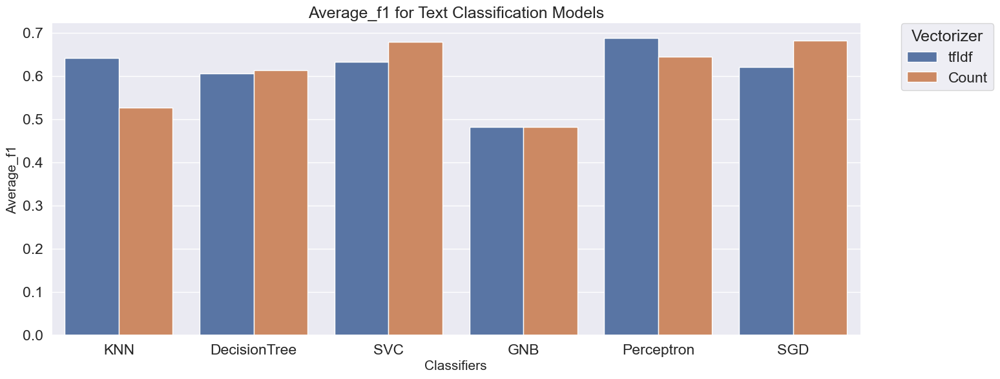

In [36]:
dicScoresCopy = dicScores.copy()
dicScoresCopy.pop("Classifier")
resultsDf = pd.DataFrame(dicScores)
sns.set_style('darkgrid')
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 2.5})

# create the bar plot
best_results_bar = sns.catplot(
    x='ClassifierName', 
    y='Average_f1', 
    hue='Vectorizer', 
    data=resultsDf, 
    kind='bar', 
    legend=False, 
    palette='deep', 
    alpha=1, 
    height=6, 
    aspect=2.3
)

# set the labels for the plot
best_results_bar.set_xlabels("Classifiers", fontsize=15)
best_results_bar.set_ylabels("Average_f1", fontsize=15)

# set the title for the plot
plt.title('Average_f1 for Text Classification Models', fontsize=18)

# adjust the legend position
plt.legend(title="Vectorizer", bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
        
# show the plot
plt.show()

### similarityCheck Function to Try to Improve the Model
------------------------------
This function is getting two words as input , and trying to realize if those words has the same stem.
so if they are the function will return the longer word, otherwise it will return False.

In [37]:
def similarityCheck(str1, str2):
    set1 = set(str1)
    set2 = set(str2)
    intersection = len(set1.intersection(set2))
    union = len(set1.union(set2))
    similarity = intersection / union
    if(similarity >= 0.85):
          if(len(str1) < len(str2)):
            return str2
          else:
            return str1
    else:
        return False

word= similarityCheck("אאוט","אוט")


print(f"word is:{word}")

word is:אאוט


In [38]:
dfTrainSim = df_train.copy()
dfTrainSim['gender_label']=dfTrainSim['gender'].apply(lambda gen: 1 if gen=='m' else 0)
preProcess(dfTrainSim)

tfVecSim = TfidfVectorizer()
xTrainID = createVectorizer(dfTrainSim,tfVecSim,True)
xTrainID.head(5)


,אאוט,אאוטפיטים,אב,אבא,אבבה,אבד,אבדה,אבדוק,אבדנו,אבהות,אבו,אבוא,אבוב,אבוד,אבודה,אבודי,אבודים,אבוי,אבוני,אבוקות,אבות,אבותינו,אבזרנו,אבחון,אבחר,אבטחה,אבטחת,אבטיח,אבטלה,אבי,אביא,אביב,אביבי,אביביים,אביבית,אבידת,אביה,אביהן,אביו,אביזרים,אבים,אבין,אבל,אבן,אבנה,אבנים,אבק,אבקר,אבקש,אברהם,אברח,אבריא,אבשלום,אג,אגב,אגדה,אגדיל,אגודת,אגוון,אגיב,אגיד,אגיע,אגם,אגמים,אגן,אגרום,אגרסיבי,אגרסיבית,אגרסיות,אגשים,אדאג,אדביק,אדבק,אדווייזור,אדווין,אדום,אדומה,אדומות,אדון,אדוני,אדי,אדיב,אדיבות,אדיבים,אדידס,אדים,אדיס,אדיר,אדירה,אדירות,אדירים,אדירכלית,אדיש,אדם,אדמדמים,אדמה,אדממה,אדני,אדע,אדריכלות,אדריכלים,אדרנלין,אה,אהב,אהבה,אהבו,אהבנו,אהבת,אהבתי,אהדה,אהוב,אהובה,אהובים,אהובתי,אהיה,אהנה,או,אוב,אובד,אובדן,אובחנתי,אובט,אובי,אובייקט,אובייקטים,אובר,אוגוסט,אוגנדה,אודות,אודי,אודיע,אודישן,אודישנים,אודם,אוהב,אוהבות,אוהבים,אוהבת,אוהג,אוהד,אוהדי,אוהדים,אוהל,אוהלים,אוואי,אוודא,אווי,אוויס,אוויר,אווירה,אווירי,אווירית,אווירת,אוורירי,אוותר,אוזן,אוזניות,אוזניי,אוזניים,אוחזת,אוט,אוטו,אוטובוס,אוטובוסים,אוטובסים,אוטוטו,אוטומט,אוטומטי,אוטומטיות,אוטומטים,אוטומטית,אוטומציה,אוטנטית,אוי,אויב,אויירת,אויר,אוירה,אוכל,אוכלוסיות,אוכלוסייה,אוכלוסית,אוכלות,אוכלים,אוכלסיות,אוכלת,אולד,אולטרא,אולטרה,אולטרסאונד,אולי,אוליי,אולימפיקו,אולם,אולמות,אולפן,אולפני,אולר,אומגה,אומגות,אומטפה,אומלל,אומנה,אומנות,אומנים,אומנם,אומץ,אומר,אומרות,אומרים,אומרת,אונו,אוניברסיטאי,אוניברסיטה,אוניברסיטת,אוניברסלי,אוניה,אונייה,אונים,אוניסריטה,אונליין,אוסבורן,אוסטריה,אוסטרליה,אוסיף,אוסישקין,אוסף,אוספים,אוסקורפ,אוסר,אוף,אופטיות,אופטימי,אופטימיות,אופטימיים,אופטימים,אופטימית,אופטלגין,אופי,אופיה,אופיים,אופייני,אופיס,אופיר,אופן,אופנה,אופנוע,אופנועי,אופנועים,אופני,אופניים,אופנים,אופנעי,אופנתיים,אופציה,אופציות,אופציית,אופק,אופקים,אופתע,אוצה,אוציא,אוקטובר,אוקטופוס,אוקטן,אוקי,אוקיי,אוקראיני,אור,אורגניי,אורו,אורוכות,אורות,אורז,אורח,אורחי,אורחים,אורחת,אורט,אורטופד,אורי,אוריד,אורך,אורכה,אורכו,אורשה,אורתופדי,אושוויה,אושפז,אושפזתי,אושר,אושרה,אות,אותה,אותו,אותוו,אותות,אותותיה,אותי,אותיות,אותך,אותכם,אותם,אותן,אותנו,אותנטי,אותנטיות,אותנטיים,אותנטים,אותנטית,אותתי,אז,אזהרה,אזהרות,אזובים,אזור,אזורי,אזורים,אזי,אזיז,אזכה,אזכור,אזעקה,אזעקת,אזק,אזקו,אזרוק,אזרח,אזרחות,אזרחי,אזרחיות,אזרחים,אזרחית,אזרתי,אח,אחאי,אחאנו,אחגוג,אחד,אחדות,אחה,אחווה,אחוז,אחוזי,אחוזים,אחורה,אחורי,אחורנה,אחורנית,אחוש,אחות,אחותה,אחותו,אחותי,אחזור,אחזקה,אחזתי,אחי,אחיה,אחיו,אחיותי,אחיזה,אחיי,אחייג,אחיין,אחיינים,אחים,אחיניותיי,אחכ,אחכה,אחלה,אחמד,אחסון,אחפור,אחפש,אחר,אחראי,אחראיות,אחראים,אחראית,אחרון,אחרונה,אחרונות,אחרונים,אחרות,אחרי,אחריה,אחריהם,אחריהן,אחריו,אחריות,אחריותה,אחריי,אחרים,אחרינו,אחריץ,אחרכך,אחרת,אחשוש,אחת,אחתום,אט,אטומה,אטוס,אטיב,אטייל,אטלנטה,אטלנטיס,אטפל,אטרף,אטרקטיבית,אטרקיצה,אטרקציה,אטרקציות,אי,איאוו,איבד,איבדה,איבדו,איבדנו,איבדתי,איבוד,איבר,איברהיים,איגדנו,איגוד,איגוסטרס,אידיאולוגיות,אידיאלי,איה,איו,איוורור,איולי,איום,איומה,איומי,איומים,איז,איזה,איזו,איזון,איזור,איזושהי,איזנקוט,איזשהו,איזשהי,איזשהיא,איחדה,איחוד,איחור,איחל,איחלנו,איחלתי,איחר,איחרה,איחרנו,איחרתי,איטי,איטיים,איטית,איטליה,איטלקי,איטלקים,איטלקית,איי,אייל,איילון,איילים,איים,איימה,איימים,איימל,איימתי,איינהירנינגור,איינטנסיבים,איינשטיין,אייפד,אייפון,אייפל,איירביאנדבי,אייריס,איישתי,איך,איכון,איכות,איכותי,איכותיים,איכותית,איכזב,איכלס,איכן,איכפת,איכרים,איכשהו,איל,אילו,אילון,אילוף,אילוצי,אילצה,אילת,אילתים,אילתרתי,אימא,אימה,אימו,אימון,אימוני,אימונים,אימוץ,אימי,אימייל,אימיילים,אימים,אימצנו,אימצתי,אימתה,אין,אינדיבידואלי,אינדקציה,אינה,אינו,אינטגרלי,אינטגרציות,אינטימי,אינטימיות,אינטימית,אינטליגנטית,אינטלקטואלית,אינטנסיבי,אינטנסיביים,אינטנסיבית,אינטסיבי,אינטפדת,אינטר,אינטראקציה,אינטראקציות,אינטרנט,אינטרנטי,אינטרנטית,אינטרס,איני,אינך,אינם,איננה,איננו,אינני,אינסוף,אינסופי,אינסופיים,אינסופית,אינסטגרם,אינסטינקט,אינסטלטור,אינסטלציה,אינסטנבול,אינספור,אינפוזיה,אינפורמטיבית,אינפינטי,אינפסופיות,איסוף,איסור,איסטנבול,איסלא,איסלה,איסתיקלל,איפה,איפוס,איפוסט,איפיון,איפנמה,איפרו,איפשהו,איפשרה,איפשרו,איצטדיון,איציק,איקס,אירגונים,אירגן,אירגנו,אירגנתי,אירו,אירובי,אירוח,אירוסול,אירוע,אירועים,אירופאי,אירופאיים,אירופה,איש,אישה,אישומים,אישור,אישורי,אישורים,אישי,אישיות,אישיים,אישית,אישפוז,אישר,אישרו,אישרתי,אישתי,איתה,איתו,איתי,א

In [39]:
## Check 1 only with same first letter
xTrainID1 = xTrainID.copy()
allCols = xTrainID.columns.tolist()
colsToDel = []
for col in range(0,len(allCols)-1):
    wordO = allCols[col]
    for colT in range(col+1,len(allCols)-1):
        wordT = allCols[colT]
        
        if(wordO[0] == wordT[0]):
            wordToDel = similarityCheck(wordO,wordT)
            if(wordToDel != False):
                
                if(wordToDel not in colsToDel):
                    colsToDel.append(wordToDel)
                if(wordToDel == wordO):
                    break
               
                
xTrainID1.drop(colsToDel,axis=1,inplace=True)
clf1 = flow(xTrain=xTrainID1, yTrain=df_train_copy['gender_label'], modelAlgo=Perceptron)

0.87 f1 male with a standard deviation of 0.01

0.42 f1 female with a standard deviation of 0.14

0.64 f1 macro average 



In [40]:
## Check 2  without same first letter
xTrainID2 = xTrainID.copy()
allCols = xTrainID.columns.tolist()
colsToDel = []
for col in range(0,len(allCols)-1):
    wordO = allCols[col]
    for colT in range(col+1,len(allCols)-1):
        wordT = allCols[colT]
        
        wordToDel = similarityCheck(wordO,wordT)
        if(wordToDel != False):
            if(wordToDel not in colsToDel):
                 colsToDel.append(wordToDel)
                
            if(wordToDel == wordO):
                 break

xTrainID2.drop(colsToDel,axis=1,inplace=True)
clf2 = flow(xTrain=xTrainID2, yTrain=df_train_copy['gender_label'], modelAlgo=Perceptron)                    

0.87 f1 male with a standard deviation of 0.01

0.42 f1 female with a standard deviation of 0.14

0.64 f1 macro average 



In [51]:
df_testCopyFinal = df_test.copy()
preProcess(df_testCopyFinal)

X_test = []
for tk in df_testCopyFinal["tokens"]:
    X_test.append(' '.join(tk))
    
yNum = dicScores["Classifier"][8].predict(X_test)
yFinal=[]
for i in yNum:
    if(i == 1):
        yFinal.append("m")
    else:
        yFinal.append("f")

### Save output to csv (optional)
After you're done save your output to the 'classification_results.csv' csv file.<br/>
We assume that the dataframe with your results contain the following columns:
* column 1 (left column): 'test_example_id'  - the same id associated to each of the test stories to be predicted.
* column 2 (right column): 'predicted_category' - the predicted gender value for each of the associated story. 

Assuming your predicted values are in the `df_predicted` dataframe, you should save you're results as following:

In [52]:
df_predicted = df_test.copy()
df_predicted["Predict_Gender"] = yFinal
df_predicted.to_csv('classification_results.csv',index=False)

In [53]:
df_predicted.head(5)


,test_example_id,story,Predict_Gender
0,0,כל קיץ אני והמשפחה נוסעים לארצות הברית לוס אנג...,m
1,1,"הגעתי לשירות המדינה אחרי שנתיים כפעיל בתנועת ""...",m
2,2,אחת האהבות הגדולות שלי אלו הכלבים שלי ושל אישת...,m
3,3,"רגע הגיוס לצבא היה הרגע הכי משמעותי עבורי, אני...",m
4,4,אני הגעתי לברזיל ישר מקולומביה וגם אני עשיתי ע...,m


In [54]:
df_predicted.tail(5)

,test_example_id,story,Predict_Gender
318,318,"בשנה האחרונה הרגשתי די תקוע בעבודה, השגרה הפכה...",m
319,319,אני ואילן חברים טובים מזה 20 שנה תמיד חלמנו לפ...,m
320,320,מידי יום שישי אני נוהג לנסוע בתחבורה ציבורית ס...,m
321,321,"לפני מספר חודשים, בשיא התחלואה של הגל השני, עמ...",m
322,322,היום בו דיווחתי על גניבה של האוטו שלי. בוקר אח...,m
